<b>Data mining Project - 2021/22</b><br/>
<span>
<b>Authors:</b> Mariagiovanna Rotundo (560765), Nunzio Lopardo (600005)</a> and Renato Eschini (203021)<br/>
<b>Group:</b>3<br/>
<b>Release date:</b> 26/12/2021
</span>

# Task 2: Data Clustering

This workbook contains a clustering analysis on the tennis dataset.
This dataset was derived from the "tennis_matches.csv" dataset by deriving player information from the matches played.

A new "performance" dataset was also derived in which the data was reprocessed to use only essential and important information for a player-related clustering analysis, eg. only players who have played more than a certain number of games will be considered, only numerical attributes, percentages strictly greater than zero, etc.

**Importing libraries**

In [1]:
import math
from datetime import date
import re
import collections
import os

import numpy as np

import matplotlib.pyplot as plt

import scipy.stats as stats
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.cluster import AgglomerativeClustering

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import davies_bouldin_score, silhouette_score, calinski_harabasz_score, pairwise_distances
from sklearn.neighbors import NearestNeighbors

import pandas as pd

from tqdm.notebook import tqdm

from pyclustering.cluster.xmeans import xmeans
from pyclustering.cluster.gmeans import gmeans
from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer
from pyclustering.cluster import cluster_visualizer, cluster_visualizer_multidim

import seaborn as sns

from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

**Loading the dataset**

Load "players.csv"

In [2]:
# load of the data
DATASET_DIR = '..' + os.path.sep + "dataset" + os.path.sep
#index_col=False say to not use the first column as ID
df_players = pd.read_csv(DATASET_DIR + 'players.csv', sep=',', index_col=0) 
df_players.head()

,whole_name,sex,ioc,id,hand,best_rank,best_rank_points,best_of_3_match,best_of_5_match,best_of_3_wins,...,nmatch,w_surface_Hard,w_surface_Clay,w_surface_Grass,w_surface_Carpet,l_surface_Hard,l_surface_Clay,l_surface_Grass,l_surface_Carpet,n_tourney
0,Kei Nishikori,M,JPN,105453.0,R,4,5010,208,75,135,...,283,117,56,18,0,55,28,9,0,91
1,Daniil Medvedev,M,RUS,106421.0,R,2,10620,324,58,229,...,382,205,27,35,0,73,26,16,0,129
2,Jo Wilfried Tsonga,M,FRA,104542.0,R,7,3480,148,49,95,...,197,91,23,11,0,46,18,8,0,82
3,Jeremy Chardy,M,FRA,104871.0,R,28,1265,242,38,135,...,280,89,40,20,0,77,39,15,0,133
4,Alex De Minaur,M,AUS,200282.0,R,15,2690,234,38,145,...,272,117,16,31,0,68,25,15,0,114


Print info

In [3]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10102 entries, 0 to 10102
Data columns (total 45 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   whole_name        10102 non-null  object 
 1   sex               10102 non-null  object 
 2   ioc               10102 non-null  object 
 3   id                10102 non-null  float64
 4   hand              10102 non-null  object 
 5   best_rank         10102 non-null  int64  
 6   best_rank_points  10102 non-null  int64  
 7   best_of_3_match   10102 non-null  int64  
 8   best_of_5_match   10102 non-null  int64  
 9   best_of_3_wins    10102 non-null  int64  
 10  best_of_5_wins    10102 non-null  int64  
 11  m_16              10102 non-null  int64  
 12  w_16              10102 non-null  int64  
 13  m_17              10102 non-null  int64  
 14  w_17              10102 non-null  int64  
 15  m_18              10102 non-null  int64  
 16  w_18              10102 non-null  int64 

## Perfomances dataset

We analyze the distribution of players by number of matches played

<AxesSubplot:xlabel='nmatch', ylabel='Count'>

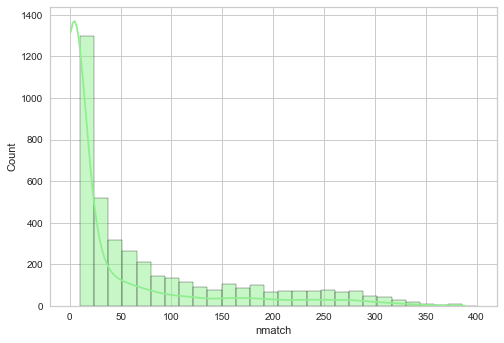

In [4]:
sns.histplot(data=df_players['nmatch'], bins="auto", binrange=(10,400), color="lightgreen", kde=True)

<AxesSubplot:xlabel='best_rank', ylabel='Count'>

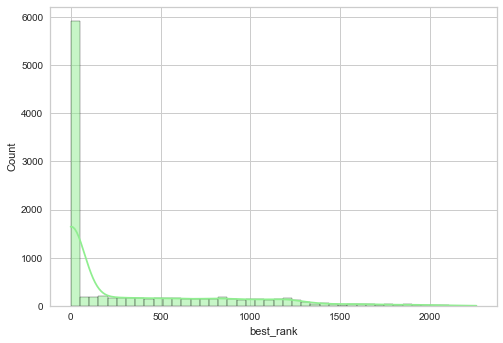

In [5]:
sns.histplot(data=df_players['best_rank'], bins="auto", color="lightgreen", kde=True)

We create the performance dataset by taking only some attributes and the players who have at least a fixed number of n_match games (for example at least 100 games played)

In [6]:
n_match = 100

df_performances_org = df_players[
    (df_players['best_rank']>0) & 
    (df_players['best_rank_points']>=0) & 
    (df_players['tot_minutes']>0) & 
    (df_players['ace']>=0) & 
    (df_players['bpS']>=0)][[
'best_rank', 
'best_rank_points',                            
'tot_minutes',
'sv1st_win', 
'sv2nd_win', 
'df', 
'ace', 
'bpS', 
'nmatch', 
'best_of_3_match', 
'best_of_3_wins', 
'best_of_5_match', 
'best_of_5_wins', 
'wmatch',
'lmatch', 
'w_tourney',
'n_tourney']]
df_performances = df_performances_org.loc[df_performances_org['nmatch'] > n_match]

df_performances

,best_rank,best_rank_points,tot_minutes,sv1st_win,sv2nd_win,df,ace,bpS,nmatch,best_of_3_match,best_of_3_wins,best_of_5_match,best_of_5_wins,wmatch,lmatch,w_tourney,n_tourney
0,4,5010,33023.911876,9825,4689,644,872.0,1154.0,283,208,135,75,56,191,92,3,91
1,2,10620,38112.287152,12334,5789,1205,2854.0,1305.0,382,324,229,58,38,267,115,14,129
2,7,3480,21506.786448,7474,3168,504,1917.0,636.0,197,148,95,49,30,125,72,7,82
3,28,1265,28833.134645,9835,3998,1119,2227.0,1049.0,280,242,135,38,14,149,131,1,133
4,15,2690,29048.475556,8699,4431,742,968.0,1051.0,272,234,145,38,19,164,108,6,114
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4392,296,730,9651.623291,0,0,0,0.0,0.0,117,117,80,0,0,80,37,2,40
4447,521,1114,9154.137425,0,0,0,0.0,0.0,116,116,69,0,0,69,47,1,48
4605,425,1112,8103.048731,32,9,10,2.0,5.0,104,104,57,0,0,57,47,2,50
4804,752,1219,8189.388549,0,0,0,0.0,0.0,108,108,67,0,0,67,41,1,42


## Elimination of highly correlated features

We begin by examining the correlations between the attributes of the dataset to be clustered in order to identify the highly correlated couples. Dropping redundant attributes benefits the analysis by reducing the dimensionality of the dataset and rising the influence that more useful feature could have on the whole clustering process.

With such aim in mind, we fix a maximum threshold value in order to identify highly correlated features and subsequently drop them.

<AxesSubplot:>

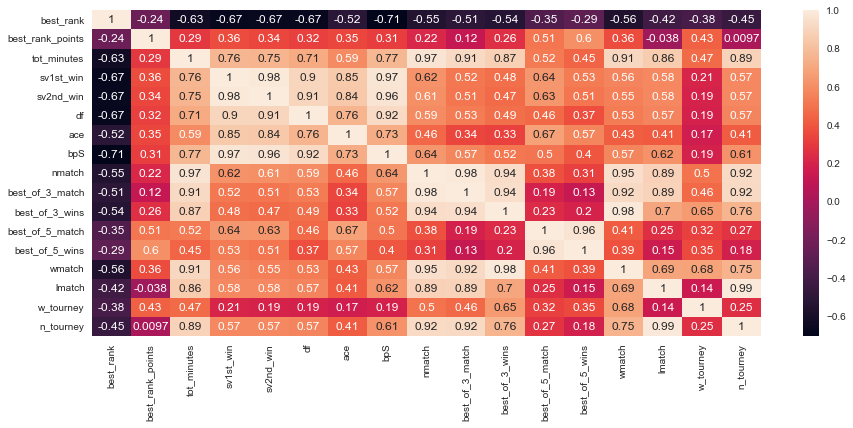

In [7]:
plt.figure(figsize = (15,6))
sns.heatmap( df_performances.corr(), annot=True)

In [8]:
corr_threshold = 0.9
print("Att. A\t\t\tAtt. B\t\t\tCorr(A,B)")
for i in range(0, len(df_performances.columns)):
    for j in range(i+1, len(df_performances.columns)):
        corr = df_performances[df_performances.columns[i]].corr(df_performances[df_performances.columns[j]])
        if  corr > corr_threshold:
            print(df_performances.columns[i] + "\t\t\t" + df_performances.columns[j] + "\t\t\t" + '{:.4f}'.format(corr))

Att. A			Att. B			Corr(A,B)
tot_minutes			nmatch			0.9654
tot_minutes			best_of_3_match			0.9139
tot_minutes			wmatch			0.9115
sv1st_win			sv2nd_win			0.9846
sv1st_win			df			0.9015
sv1st_win			bpS			0.9682
sv2nd_win			df			0.9055
sv2nd_win			bpS			0.9633
df			bpS			0.9227
nmatch			best_of_3_match			0.9811
nmatch			best_of_3_wins			0.9381
nmatch			wmatch			0.9456
nmatch			n_tourney			0.9217
best_of_3_match			best_of_3_wins			0.9448
best_of_3_match			wmatch			0.9152
best_of_3_match			n_tourney			0.9195
best_of_3_wins			wmatch			0.9802
best_of_5_match			best_of_5_wins			0.9608
lmatch			n_tourney			0.9915


In [9]:
#   
corr_columns = ['best_of_3_match', 'best_of_5_match', 'sv2nd_win', 'tot_minutes']
tmp = df_performances.drop(corr_columns, axis=1, inplace=False)
df_performances = tmp
df_performances

,best_rank,best_rank_points,sv1st_win,df,ace,bpS,nmatch,best_of_3_wins,best_of_5_wins,wmatch,lmatch,w_tourney,n_tourney
0,4,5010,9825,644,872.0,1154.0,283,135,56,191,92,3,91
1,2,10620,12334,1205,2854.0,1305.0,382,229,38,267,115,14,129
2,7,3480,7474,504,1917.0,636.0,197,95,30,125,72,7,82
3,28,1265,9835,1119,2227.0,1049.0,280,135,14,149,131,1,133
4,15,2690,8699,742,968.0,1051.0,272,145,19,164,108,6,114
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4392,296,730,0,0,0.0,0.0,117,80,0,80,37,2,40
4447,521,1114,0,0,0.0,0.0,116,69,0,69,47,1,48
4605,425,1112,32,10,2.0,5.0,104,57,0,57,47,2,50
4804,752,1219,0,0,0.0,0.0,108,67,0,67,41,1,42


**Distance Matrix**

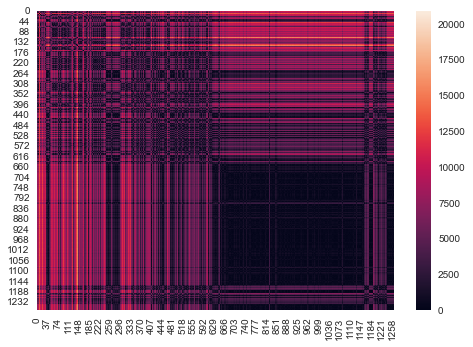

<Figure size 720x720 with 0 Axes>

In [10]:
from sklearn.metrics.pairwise import euclidean_distances
distance_matrix = euclidean_distances(df_performances, df_performances)
ax = sns.heatmap(distance_matrix)
plt.figure(figsize = (10,10))
plt.show()

## K-Means

## Identification of the best value of k 
The **K** parameter represents the number of clusters into which we want to divide the dataset. <br />
There are different methods to calculate the value of K. <br />
Below we use the **Elbow** method with a ready-made library and by simulating clustering with different k and then measuring the results obtained by **Sum of Square Errors (SSE)** and by **Silhouette**, then measuring the results.

#### KElbowVisualizer with 3 different metrics

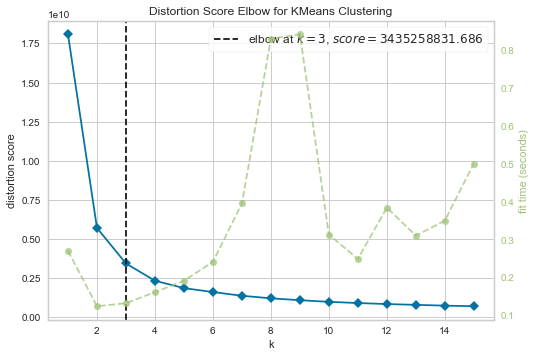

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [11]:
# Instantiate the clustering model and visualizer with 
# mean sum of squared distances to centers (distortion) metric

model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,16), metric="distortion")

visualizer.fit(df_performances)        # Fit the data to the visualizer
visualizer.show()                      # Finalize and render the figure

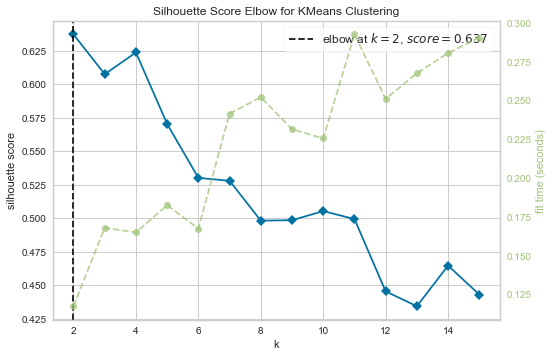

<AxesSubplot:title={'center':'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [12]:
# Instantiate the clustering model and visualizer with 
# mean ratio of intra-cluster and nearest-cluster distance (silhouette)

model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,16), metric="silhouette")

visualizer.fit(df_performances)        # Fit the data to the visualizer
visualizer.show()                      # Finalize and render the figure

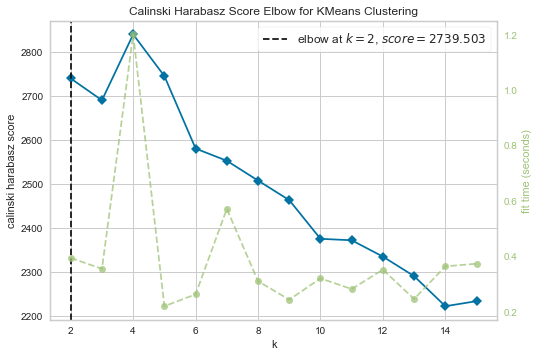

<AxesSubplot:title={'center':'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [13]:
# Instantiate the clustering model and visualizer with 
# ratio of within to between cluster dispersion (calinski_harabasz)

model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,16), metric="calinski_harabasz")

visualizer.fit(df_performances)        # Fit the data to the visualizer
visualizer.show()                      # Finalize and render the figure

#### Simulate different clustering with different K and evaluate by hand silhouette_score and sum of standard error

In [14]:
sse_list = list()
sil_list = list()
k_cols = []

max_k = 16
for k in tqdm(range(2, max_k + 1), total=max_k - 1, desc="Iterating over possible K values"):
    kmeans_iter = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans_iter.fit(df_performances)        
    sil_list.append(silhouette_score(df_performances, kmeans_iter.labels_))
    sse = int(kmeans_iter.inertia_)
    sse_list.append(sse)
    k_cols.append(str(k))
    
store_results=pd.DataFrame()
store_results['K'] = k_cols
store_results['SSE'] = sse_list
store_results['Silhouette'] = sil_list
store_results.set_index(['K'], inplace=True)
store_results

Iterating over possible K values:   0%|          | 0/15 [00:00<?, ?it/s]

,SSE,Silhouette
K,,
2,5705165593,0.637339
3,3435258831,0.607642
4,2331120432,0.623832
5,1861197140,0.570428
6,1606651259,0.529978
7,1381420546,0.537469
8,1209064613,0.497889
9,1096400210,0.487729
10,984000337,0.505833


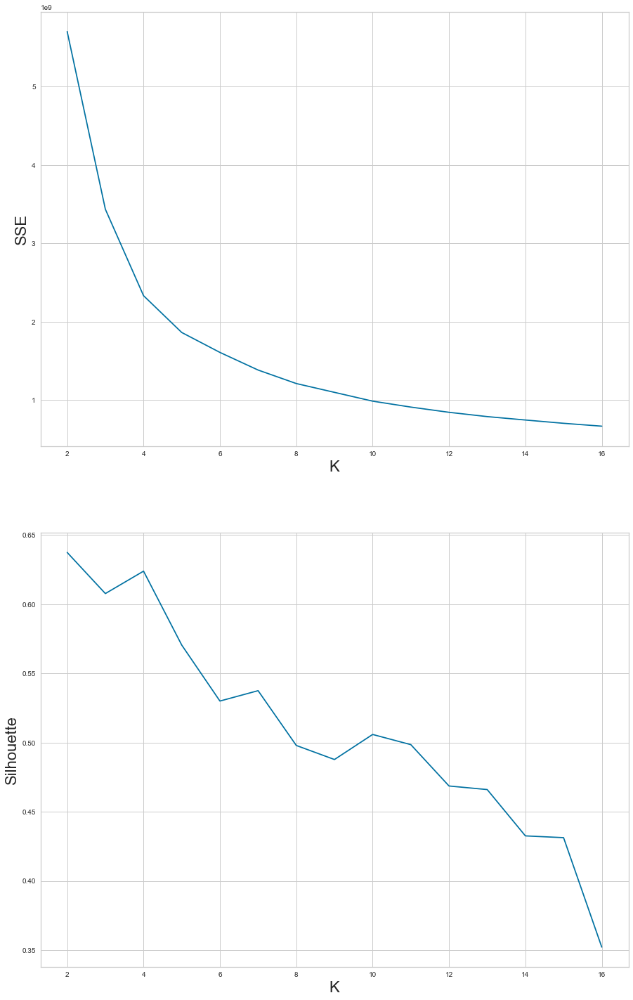

In [15]:
# plot indicators
fig, axs = plt.subplots(2,1,figsize=(15,25))
axs[0].plot(range(2, len(sse_list) + 2), sse_list)
axs[0].set_ylabel('SSE', fontsize=22)
axs[0].set_xlabel('K', fontsize=22)
axs[0].tick_params(axis='both', which='major', labelsize=10)

axs[1].plot(range(2, len(sil_list) + 2), sil_list)
axs[1].set_ylabel('Silhouette', fontsize=22)
axs[1].set_xlabel('K', fontsize=22)
axs[1].tick_params(axis='both', which='major', labelsize=10)

**We can assume that this is the best value of k**

In [16]:
n_clusters = 4

**Normalization** <br/>
We normalize the values using MinMax in order to have the same scale on all attributes

In [17]:
scaler = MinMaxScaler()
X = scaler.fit_transform(df_performances.values)

**Silhouette Viewer**
The Silhouette Viewer displays the silhouette coefficient for each sample on a per cluster basis, visually evaluating the density and separation between clusters.

In the SilhouetteVisualizer charts, clusters with higher scores have wider shapes, but less cohesive clusters will be below the average score across all clusters, which is plotted as a vertical dashed red line.

This is particularly useful for determining cluster imbalance or for selecting a value for K by comparing multiple viewers.

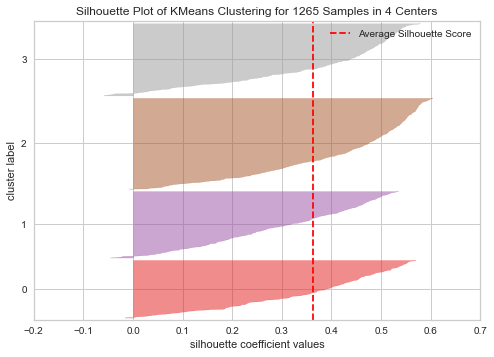

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 1265 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [18]:
model = KMeans(n_clusters)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

In [19]:
# calculate the cluster
kmeans = KMeans(n_clusters, n_init=10, max_iter=100)
kmeans.fit(X)

KMeans(max_iter=100, n_clusters=4)

In [20]:
# print the unique labels identified by K-Means
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3]), array([256, 293, 398, 318], dtype=int64))

In [21]:
# print the number of items for each cluster
hist, bins = np.histogram(kmeans.labels_, bins=range(0, len(set(kmeans.labels_)) + 1))
dict(zip(bins, hist))

{0: 256, 1: 293, 2: 398, 3: 318}

In [22]:
# print the center of clusters
kmeans.cluster_centers_

array([[ 2.22671174e-01,  2.64172255e-02,  6.04164874e-02,
         6.33228902e-02,  1.05200423e-02,  9.99628703e-02,
         4.90390897e-01,  4.98365226e-01, -1.73472348e-17,
         4.25296640e-01,  5.00760277e-01,  1.62471065e-01,
         5.36589478e-01],
       [ 1.20607880e-01,  5.70804129e-02,  2.87075816e-01,
         2.17510092e-01,  1.00890529e-01,  3.63741201e-01,
         2.12591122e-01,  2.69925276e-01,  1.73913043e-02,
         2.37868562e-01,  3.00272579e-01,  6.67425104e-02,
         2.95405996e-01],
       [ 4.43446939e-01,  4.17730945e-02,  1.00917526e-02,
         1.13792312e-02,  2.02123840e-03,  1.65802973e-02,
         1.42384396e-01,  2.31244327e-01,  4.51028104e-17,
         1.97340084e-01,  2.37395029e-01,  6.45821701e-02,
         2.33523734e-01],
       [ 5.47025644e-02,  9.46155458e-02,  5.49948274e-01,
         4.05235769e-01,  2.04250548e-01,  6.71942561e-01,
         6.26432626e-01,  5.52226193e-01,  7.05769757e-02,
         5.01773301e-01,  6.26271580e

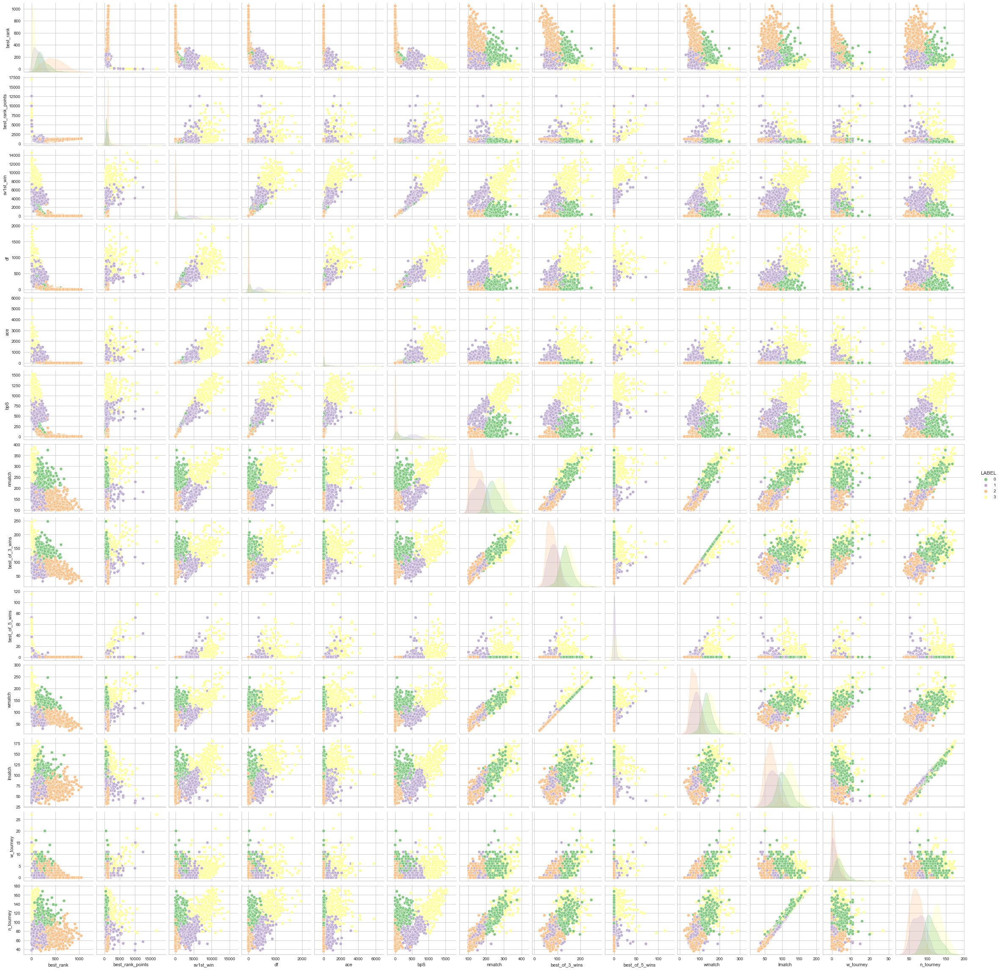

In [23]:
# Plot Clusters with Paiplot
cleaned_dataframe = df_performances.copy()
cleaned_dataframe["LABEL"] = kmeans.labels_
# Pairplot
sns.pairplot(data = cleaned_dataframe, hue = "LABEL", palette = "Accent")

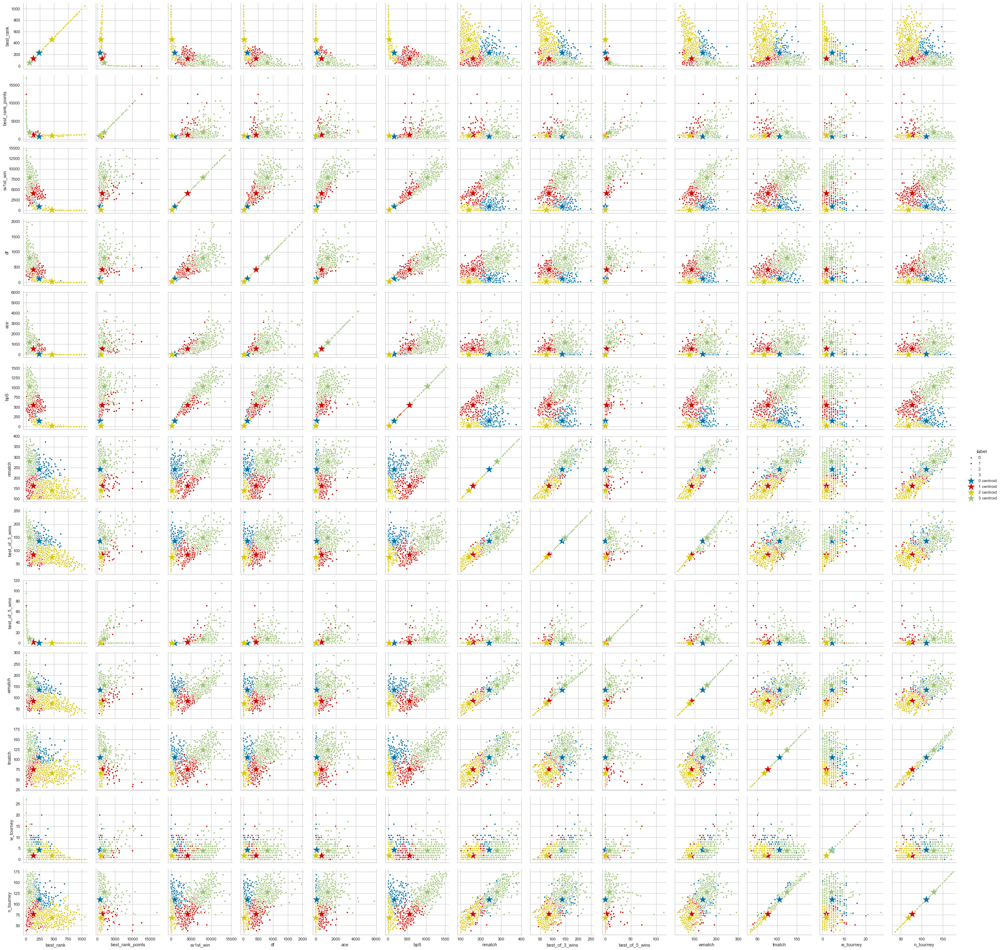

In [24]:
# Plot Clusters with PairGrid and in evidence the centroids of the clusters
cleaned_dataframe = df_performances.copy()

centroids_inversed = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns=cleaned_dataframe.columns.values)
cleaned_dataframe["label"] = kmeans.labels_.astype(str)
centroids_inversed["label"] = ["0 centroid", "1 centroid", "2 centroid", "3 centroid"]
full_ds = pd.concat([cleaned_dataframe, centroids_inversed], ignore_index=True)

g = sns.PairGrid(
                full_ds, 
                hue="label",
                hue_order=["0", "1", "2", "3", "0 centroid", "1 centroid", "2 centroid", "3 centroid"],
                palette=["b", "r", "y", "g", "b", "r", "y", "g"],
                hue_kws={
                    "s": [20, 20, 20, 20, 500, 500, 500, 500], 
                    "marker": ["o", "o", "o", "o", "*", "*", "*", "*"]}
)
g.map(plt.scatter, linewidth=1, edgecolor="w")
g.add_legend()



## DBscan

For the DBscan the dataset is normalized using 2 scalers (StandardScaler and MinMaxScaler) and both obtained dataset are analyzed. Then the parameters used by DBscan, eps (that is the distance where looking for the points) and and min number of point to create a cluster are analyzed to fins the best ones. So, the parameter are chosen with the analysis and a plot of clusters is done.

**Normalization** <br />
We normalize the values using StandardScaler in order to have the same scale on all attributes

In [25]:
scaler = StandardScaler()
scaled_array = scaler.fit_transform(df_performances)
scaled_dataframe = pd.DataFrame( scaled_array, columns = df_performances.columns )

In [26]:
scaled_dataframe.describe()

,best_rank,best_rank_points,sv1st_win,df,ace,bpS,nmatch,best_of_3_wins,best_of_5_wins,wmatch,lmatch,w_tourney,n_tourney
count,1265.000000,1.265000e+03,1.265000e+03,1265.000000,1265.000000,1.265000e+03,1265.000000,1.265000e+03,1.265000e+03,1.265000e+03,1.265000e+03,1.265000e+03,1.265000e+03
mean,0.000000,-4.493551e-17,4.493551e-17,0.000000,0.000000,-8.987102e-17,0.000000,-1.797420e-16,-4.493551e-17,1.348065e-16,-1.348065e-16,6.740326e-17,2.246775e-16
std,1.000395,1.000395e+00,1.000395e+00,1.000395,1.000395,1.000395e+00,1.000395,1.000395e+00,1.000395e+00,1.000395e+00,1.000395e+00,1.000395e+00,1.000395e+00
min,-1.116823,-7.067733e-01,-9.311258e-01,-0.945137,-0.689733,-9.955920e-01,-1.502132,-2.116324e+00,-2.901995e-01,-2.049069e+00,-2.001571e+00,-9.968733e-01,-1.907891e+00
25%,-0.791538,-4.249114e-01,-9.043448e-01,-0.905309,-0.683587,-9.537161e-01,-0.860491,-8.233634e-01,-2.901995e-01,-8.095814e-01,-8.349410e-01,-6.508127e-01,-8.210189e-01
50%,-0.310683,-2.142809e-01,-3.768750e-01,-0.250998,-0.496139,-2.464791e-01,-0.144241,-7.742435e-02,-2.901995e-01,-8.459831e-02,-1.016306e-01,-3.047522e-01,-9.643731e-02
75%,0.528456,-2.356458e-02,7.348288e-01,0.667884,0.378108,8.353143e-01,0.795838,7.182440e-01,-2.901995e-01,7.105445e-01,7.650091e-01,3.873690e-01,7.598864e-01
max,3.819013,1.202910e+01,3.298530e+00,4.659186,8.212531,2.577816e+00,2.780448,3.527948e+00,1.304001e+01,4.171754e+00,2.964941e+00,8.346762e+00,2.670147e+00


**example of clustering with fixed parameters eps and min points**

In [27]:
dbscan = DBSCAN(eps=0.75, min_samples=5)
dbscan.fit(scaled_dataframe)

DBSCAN(eps=0.75)

In [28]:
labels = dbscan.labels_
np.unique(dbscan.labels_, return_counts=True)

(array([-1,  0,  1,  2,  3,  4,  5,  6], dtype=int64),
 array([549, 681,   8,   5,   6,   5,   7,   4], dtype=int64))

with these parameters we obtain 7 clusters (plus the cluster of not classified points) and one of them has many points while the others have few points. The following picture shows the plot of clusters

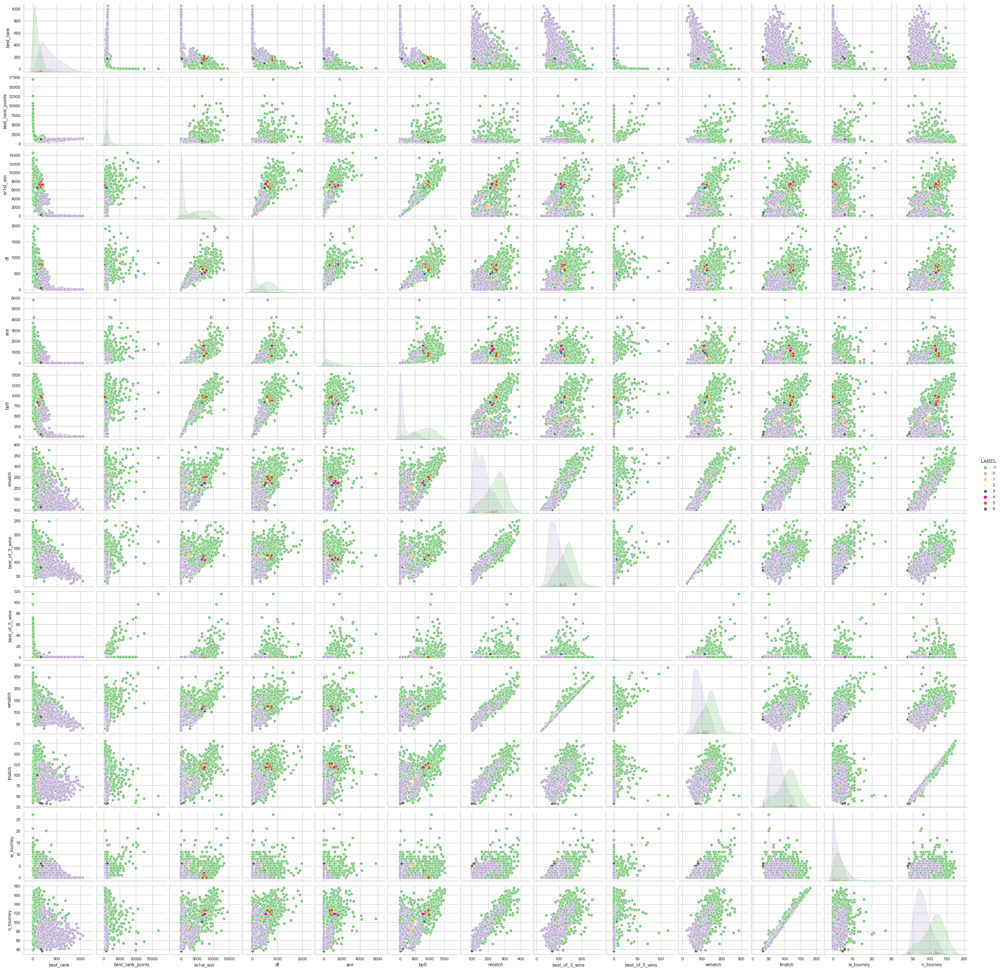

In [29]:
cleaned_dataframe = df_performances.copy()
cleaned_dataframe["LABEL"] = labels
sns.pairplot(data = cleaned_dataframe, hue = "LABEL", palette = "Accent")

**choice of parameters** <br>
To choose the best parameters more combination of eps and min samples are analyzed

In [30]:
dist = pdist(X=scaled_dataframe, metric='euclidean')  # pair-wise distance: how every record is far from all others
dist = squareform(dist)                      # distance matrix given the vector dist

Calculate the distance of the K-th neighbour, in order to find an upper bound for the eps values to analyze

In [31]:
kmin, kmax = 1, 50
kth_distances = {}
for k in range(kmin, kmax + 1): # initialize k lists
    kth_distances[k] = []

In [32]:
for d in dist:
    # argsort returns the indexes that would sort d
    index_kth_distance = np.argsort(d)[k]
    for k in range(kmin, kmax + 1):
        # append to kth_distances[k] the value in d that corresponds
        # to the distance of the i-th point (record) from its k-th nn.
        # it's like: kth_distances[k].append(sorted_d[k])), but we get "sorted_d[k]" by d[indexes_to_sort_d[k]]
        kth_distances[k].append(d[index_kth_distance])

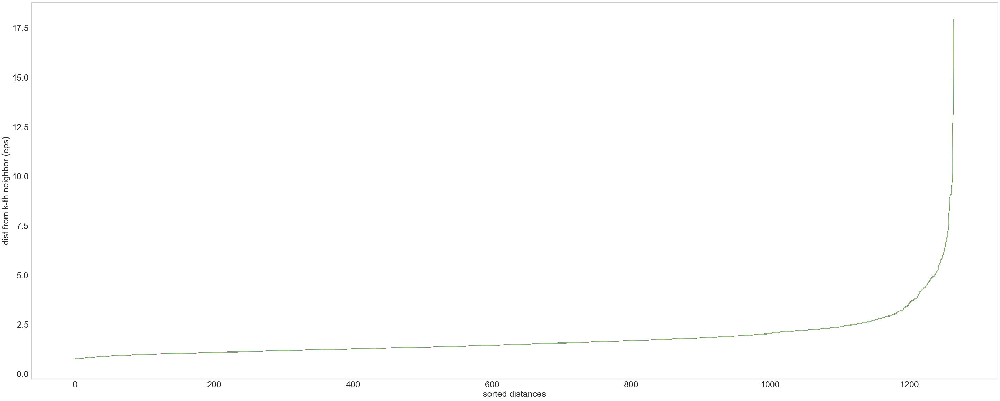

In [33]:
plt.figure(figsize=(50, 20))
for k in kth_distances.keys():
    plt.plot(range(0, len(kth_distances[k])), sorted(kth_distances[k]))
    
plt.ylabel('dist from k-th neighbor (eps)', fontsize=25)
plt.xlabel('sorted distances', fontsize=25)
#plt.ylim(top=5)
plt.ylim(bottom=-0.25)
plt.tick_params(axis='both', which='major', labelsize=25)
plt.grid()
plt.show()

#### Grid search for eps and min_samples

A function to define metrics to evaluate the parameters is defined. The define metrics are 2: the number of clusters obtained with the parameters and the mean noise between noise points and the 6 points closer (6-NN).

In [34]:
def get_metrics(eps, min_samples, dataset, iter_):
    # Fitting 
    dbscan_model_ = DBSCAN(eps = eps, min_samples = min_samples)
    dbscan_model_.fit(dataset)
    
    # Mean Noise Point Distance metric
    noise_indices = dbscan_model_.labels_ == -1
    
    if True in noise_indices:
        neighboors = NearestNeighbors(n_neighbors = 6).fit(dataset)
        distances, indices = neighboors.kneighbors(dataset)
        noise_distances = distances[noise_indices, 1:]
        noise_mean_distance = round(noise_distances.mean(), 3)
    else:
        noise_mean_distance = None
    
    # Number of found Clusters metric    
    number_of_clusters = len(set(dbscan_model_.labels_[dbscan_model_.labels_ >= 0]))
    
    #print("%3d | Tested with eps = %3s and min_samples = %3s | %5s %4s" % (i, eps, min_samples, str(noise_mean_distance), number_of_clusters))
    
    return(noise_mean_distance, number_of_clusters)

Definition of values that must be analyzed for eps and the min number of samples. Looking at the plot above the used threashold for eps is 3

In [35]:
eps_to_test = [round(x, 3) for x in np.arange(0.5, 3, 0.2)] 
min_samples_to_test = np.arange(4, 30, 2)
print(eps_to_test)
print(min_samples_to_test)

[0.5, 0.7, 0.9, 1.1, 1.3, 1.5, 1.7, 1.9, 2.1, 2.3, 2.5, 2.7, 2.9]
[ 4  6  8 10 12 14 16 18 20 22 24 26 28]


Creation of dataframes that will contain the result of analysis (one for the mean noise and one for the number of clusters)

In [36]:
# Dataframe per la metrica sulla distanza media dei noise points dai K punti più vicini
results_noise = pd.DataFrame( 
    data = np.zeros((len(eps_to_test),len(min_samples_to_test))), # Empty dataframe
    columns = min_samples_to_test, 
    index = eps_to_test
)

# Dataframe per la metrica sul numero di cluster
results_clusters = pd.DataFrame( 
    data = np.zeros((len(eps_to_test),len(min_samples_to_test))), # Empty dataframe
    columns = min_samples_to_test, 
    index = eps_to_test
)

Analysis of chosed values for the parameters

In [37]:
#search
i = 0

for eps in eps_to_test:
    for min_samples in min_samples_to_test:
        i += 1
        # Calcolo le metriche
        noise_metric, cluster_metric  = get_metrics(eps, min_samples, scaled_dataframe, i)
        # Inserisco i risultati nei relativi dataframe
        results_noise.loc[eps, min_samples] = noise_metric
        results_clusters.loc[eps, min_samples] = cluster_metric

Plot of the results of the analysis

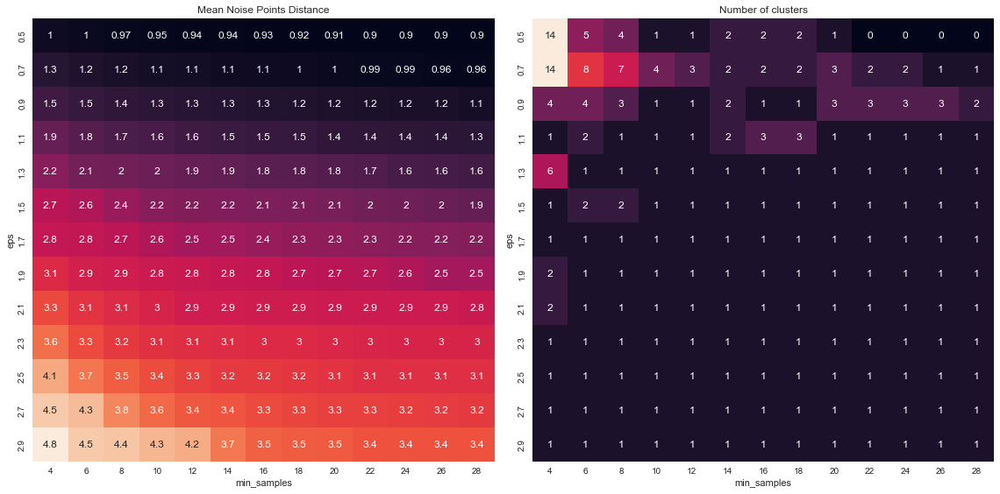

In [38]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,8) )

sns.heatmap(results_noise, annot = True, ax = ax1, cbar = False).set_title("Mean Noise Points Distance")
sns.heatmap(results_clusters, annot = True, ax = ax2, cbar = False).set_title("Number of clusters")

ax1.set_xlabel("min_samples")
ax2.set_xlabel("min_samples")
ax1.set_ylabel("eps")
ax2.set_ylabel("eps")

plt.tight_layout()
plt.show()

#### choice of parameters 

Analyzing the tables we choose eps=1.1 and min_samples=16 to obtain 3 clusters plus the one for unclassified points.

In [39]:
best_dbscan = DBSCAN(eps = 1.1, min_samples = 16)
# Fitting
best_dbscan.fit(scaled_dataframe)

labels = best_dbscan.labels_
np.unique(best_dbscan.labels_, return_counts=True)

(array([-1,  0,  1,  2], dtype=int64),
 array([427, 803,  19,  16], dtype=int64))

Plot of the new clusters

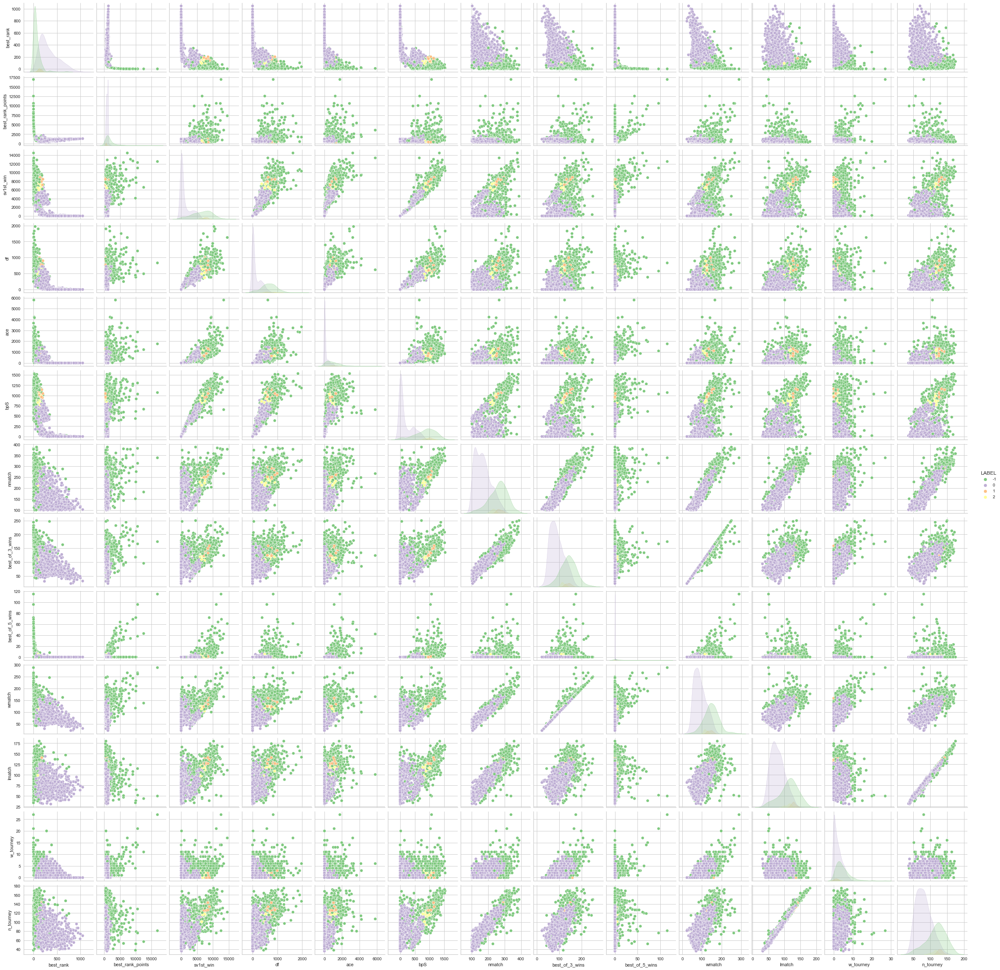

In [40]:
# Extracting labels
cleaned_dataframe = df_performances.copy()
cleaned_dataframe["LABEL"] = best_dbscan.labels_
# Pairplot
sns.pairplot(data = cleaned_dataframe, hue = "LABEL", palette = "Accent")

**Normalization** <br />
We normalize the values using MinMaxScaler in order to have the same scale on all attributes

In [41]:
scaler = MinMaxScaler()
scaled_array = scaler.fit_transform(df_performances)
scaled_dataframe = pd.DataFrame( scaled_array, columns = df_performances.columns )

**example of clustering with fixed parameters eps and min points**

In [42]:
dbscan = DBSCAN(eps=0.75, min_samples=5)
dbscan.fit(scaled_dataframe)
labels = dbscan.labels_
np.unique(dbscan.labels_, return_counts=True)

(array([-1,  0], dtype=int64), array([   1, 1264], dtype=int64))

**choice of parameters** <br>
To choose the best parameters more combination of eps and min samples are analyzed

In [43]:
dist = pdist(X=scaled_dataframe, metric='euclidean')  # pair-wise distance: how every record is far from all others
dist = squareform(dist)                      # distance matrix given the vector dist

Calculate the distance of the K-th neighbour, in order to find an upper bound for the eps values to analyze

In [44]:
kmin, kmax = 3, 50
kth_distances = {}
for k in range(kmin, kmax + 1): # initialize k lists
    kth_distances[k] = []

In [45]:
for d in dist:
    # argsort returns the indexes that would sort d
    index_kth_distance = np.argsort(d)[k]
    for k in range(kmin, kmax + 1):
        # append to kth_distances[k] the value in d that corresponds
        # to the distance of the i-th point (record) from its k-th nn.
        # it's like: kth_distances[k].append(sorted_d[k])), but we get "sorted_d[k]" by d[indexes_to_sort_d[k]]
        kth_distances[k].append(d[index_kth_distance])

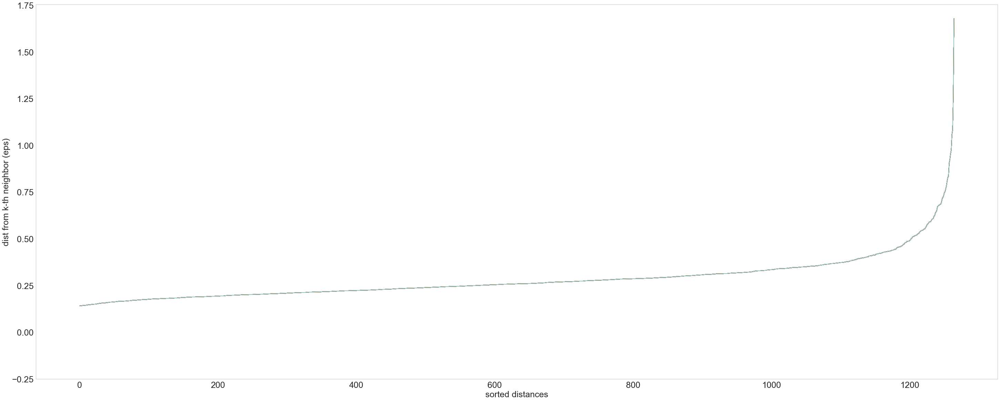

In [46]:
plt.figure(figsize=(50, 20))
for k in kth_distances.keys():
    plt.plot(range(0, len(kth_distances[k])), sorted(kth_distances[k]))
    
plt.ylabel('dist from k-th neighbor (eps)', fontsize=25)
plt.xlabel('sorted distances', fontsize=25)
#plt.ylim(top=5)
plt.ylim(bottom=-0.25)
plt.tick_params(axis='both', which='major', labelsize=25)
plt.grid()
plt.show()

Definition of values that must be analyzed for eps and the min number of samples. Looking at the plot above the used threashold for eps is 0.75

In [47]:
eps_to_test = [round(x, 3) for x in np.arange(0.1, 0.75, 0.1)]
min_samples_to_test = np.arange(2, 16, 1)
print(eps_to_test)
print(min_samples_to_test)

[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7]
[ 2  3  4  5  6  7  8  9 10 11 12 13 14 15]


Creation of dataframes that will contain the result of analysis (one for the mean noise and one for the number of clusters)

In [48]:
# Dataframe per la metrica sulla distanza media dei noise points dai K punti più vicini
results_noise = pd.DataFrame( 
    data = np.zeros((len(eps_to_test),len(min_samples_to_test))), # Empty dataframe
    columns = min_samples_to_test, 
    index = eps_to_test
)

# Dataframe per la metrica sul numero di cluster
results_clusters = pd.DataFrame( 
    data = np.zeros((len(eps_to_test),len(min_samples_to_test))), # Empty dataframe
    columns = min_samples_to_test, 
    index = eps_to_test
)

Analysis of chosed values for the parameters

In [49]:
i = 0

for eps in eps_to_test:
    for min_samples in min_samples_to_test:
        i += 1
        # Calcolo le metriche
        noise_metric, cluster_metric  = get_metrics(eps, min_samples, scaled_dataframe, i)
        # Inserisco i risultati nei relativi dataframe
        results_noise.loc[eps, min_samples] = noise_metric
        results_clusters.loc[eps, min_samples] = cluster_metric

Plot of the results of the analysis

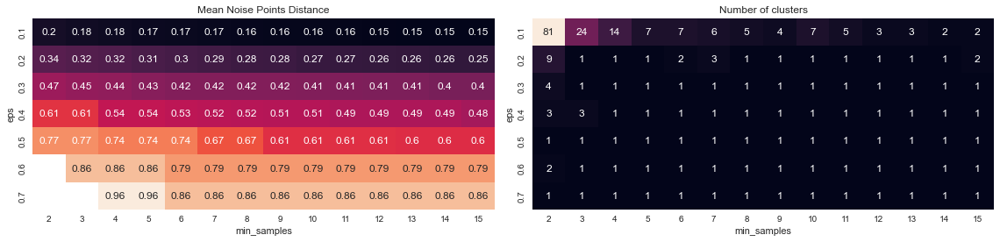

In [50]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,4) )

sns.heatmap(results_noise, annot = True, ax = ax1, cbar = False).set_title("Mean Noise Points Distance")
sns.heatmap(results_clusters, annot = True, ax = ax2, cbar = False).set_title("Number of clusters")

ax1.set_xlabel("min_samples")
ax2.set_xlabel("min_samples")
ax1.set_ylabel("eps")
ax2.set_ylabel("eps")

plt.tight_layout()
plt.show()

#### choice of parameters 

Analyzing the tables we choose eps=0.1 and min_samples=9 to obtain 4 clusters plus the one for unclassified points.

In [51]:
best_dbscan = DBSCAN(eps = 0.1, min_samples = 9)
# Fitting
best_dbscan.fit(scaled_dataframe)

labels = best_dbscan.labels_
np.unique(best_dbscan.labels_, return_counts=True)

(array([-1,  0,  1,  2,  3], dtype=int64),
 array([986,  21, 151,  95,  12], dtype=int64))

Plot of the new clusters

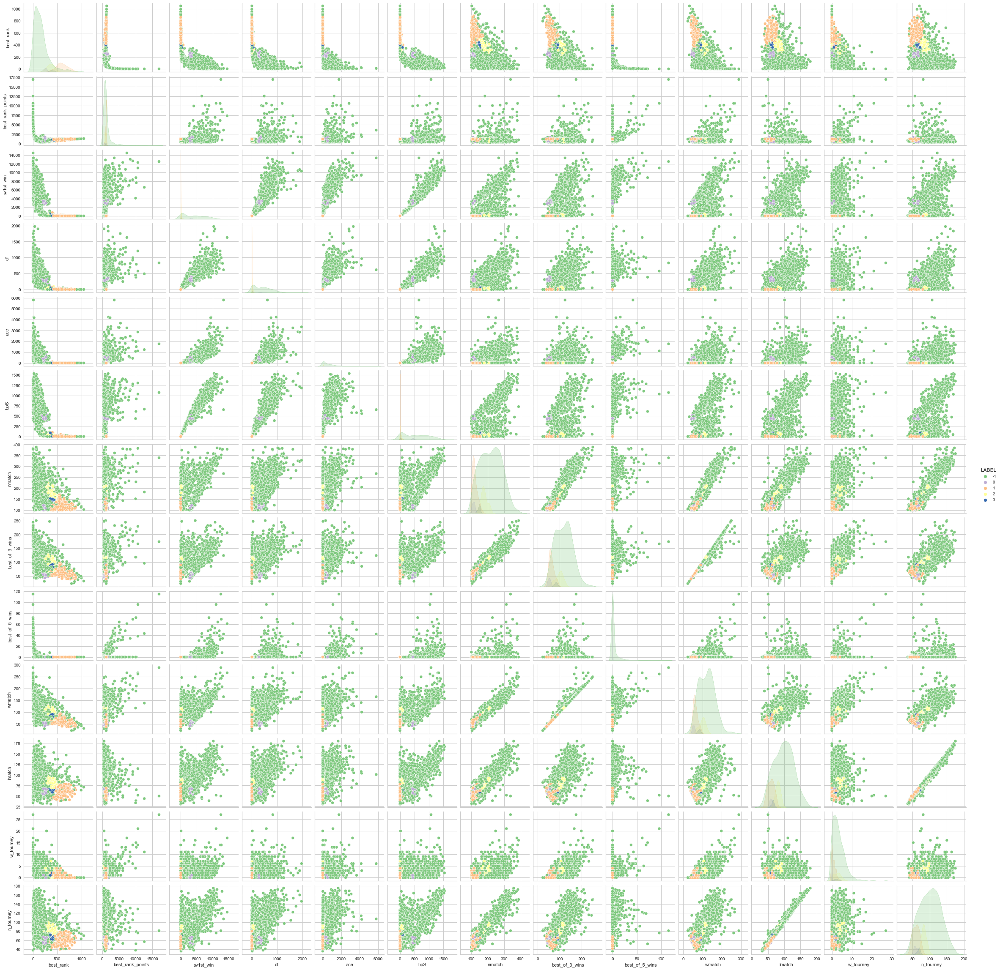

In [52]:
# Extracting labels
cleaned_dataframe = df_performances.copy()
cleaned_dataframe["LABEL"] = best_dbscan.labels_
# Pairplot
sns.pairplot(data = cleaned_dataframe, hue = "LABEL", palette = "Accent")

### Results

Analizyng wih both scalers we obtain a big cluster for unclassified points. With **StandardScaler**, this cluster has more than 400 points. About other clusters, one of them has many points (about 800) but the others have less then 20 points, so we can notice that clusters are very unbalanced. With **MinMaxScaler** the cluster of unclassified points is  even bigger with about 980 points. But some of the other clusters are relatively big (about 100 and 150 points), and some are small. So with this scaler there is not only a big cluster very big respect to the others but there are more bigger clusters and the difference between dimension of all clusters (except the unclassified one) is smaller.
To choose different parameters does not help to obtain better clusters. The clusters are not well separated and results are not as clearly describable.

# Hierachical

In this section we will see hierarchical clustering performed the divisive technique, in particular, using the four methods to compute the distances between clusters. To compute the distances has been used euclidean distance.

In [53]:
def count_cluster_elements(data, threshold, criterion='distance'):
    count = {}
    clusters = fcluster(data, threshold, criterion)
    for c in clusters:
        count[c] = count[c]+1 if c in count else 1
    return count, clusters

In [54]:
methods = ['single', 'complete', 'average', 'ward']
models = {}

Using scipy we can compute the linkage matrix and use it for the dendrogram plot. This is done for all the criteria.

- ‘**single**’ uses the minimum of the distances between all observations of the two sets.

- ‘**complete**’ or ‘**maximum**’ linkage uses the maximum distances between all observations of the two sets.

- ‘**average**’ uses the average of the distances of each observation of the two sets.

- ‘**ward**’ minimizes the variance of the clusters being merged.

**Normalization** <br />
We normalize the values using MinMaxScaler in order to have the same scale on all attributes

In [55]:
scaler = MinMaxScaler()
scaled_array = scaler.fit_transform(df_performances)
scaled_dataframe = pd.DataFrame( scaled_array, columns = df_performances.columns )

In [56]:
for method in methods:
    link = linkage(scaled_dataframe, method=method, metric = 'euclidean')
    models[method] = link

Now plot the four dendrograms.

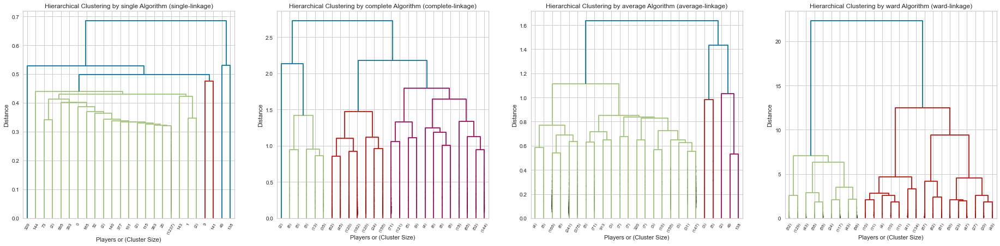

In [57]:
f, axs = plt.subplots(ncols=4, figsize=(32,7))
i = 0
for model in models.keys():
    axs[i].set_title('Hierarchical Clustering by ' + model + ' Algorithm (' + methods[i] + '-linkage)')
    axs[i].set_xlabel('Players or (Cluster Size)')
    axs[i].set_ylabel('Distance')
    dend = dendrogram(models[model],ax=axs[i],truncate_mode='lastp', p=25, leaf_rotation=60, leaf_font_size = 8, show_contracted=True)
    i+=1

Using this function we can identify the longest uninterrupted vertical segment of the dendrogram.

In [58]:
def compute_best_cut(model, scaled_dataframe):
    store_n_clusters = []
    store_distances = []
    step = 0.05
    n_clusters = 0
    i = 0

    while n_clusters != 1:
        distance_threshold = i*step
        cluster = AgglomerativeClustering(distance_threshold=distance_threshold, n_clusters=None, affinity='euclidean', linkage=model)
        cluster.fit_predict(scaled_dataframe)
        i = i + 1

        n_clusters = cluster.n_clusters_
        store_distances.append(distance_threshold)
        store_n_clusters.append(n_clusters)

    df = pd.DataFrame()
    df['distance_thresholds'] = store_distances
    df['n_clusters'] = store_n_clusters
    df_n_clusters_groups = df.groupby('n_clusters').size()
    best_cut = df_n_clusters_groups.agg(['idxmax'])[0]
    distance = df[df.n_clusters == best_cut].distance_thresholds.min()
    
    return best_cut, distance

In [59]:
cut_thresholds = {}
for model in models.keys():
    best_cut, distance = compute_best_cut(model, scaled_dataframe)
    cut_thresholds[model] = distance
print(cut_thresholds)

{'single': 0.55, 'complete': 2.2, 'average': 1.1500000000000001, 'ward': 12.55}


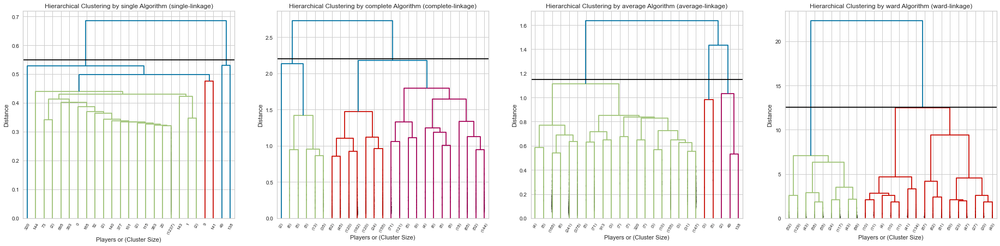

In [60]:
f, axs = plt.subplots(ncols=4, figsize=(32,7))
i = 0
for model in models.keys():
    axs[i].set_title('Hierarchical Clustering by ' + model + ' Algorithm (' + methods[i] + '-linkage)')
    axs[i].set_xlabel('Players or (Cluster Size)')
    axs[i].set_ylabel('Distance')
    axs[i].axhline(y=cut_thresholds[model], color="black")
    dend = dendrogram(models[model],ax=axs[i],truncate_mode='lastp', p=25, leaf_rotation=60, leaf_font_size = 8, show_contracted=True)
    i+=1


**Clusters evalution**

Let's compute some metrics to evaluate the clustering quality.

 **Silhouette coefficient**: defines how good the clusters are sperated. The score is bounded between -1 for incorrect clustering and +1 for highly dense clustering. Scores around zero indicate overlapping clusters.
 
 
 **Davies-Bouldin index**: means the average ‘similarity’ between clusters, where the similarity is a measure that compares the distance between clusters with the size of the clusters themselves. Values closer to zero indicate a better partition.
 
 
 **Calinski and Harabasz score**: defined as ratio between the within-cluster dispersion and the between-cluster dispersion.

In [61]:
model_labels = {}
metrics = ['silhouette', 'davies_bouldin', 'calinski_harabasz']
evaluation_metrics = pd.DataFrame(index=methods, columns=metrics)
for model in models.keys():
    print(model)
    count, clusters = count_cluster_elements(models[model], cut_thresholds[model])
    print(count)
    
    cluster = AgglomerativeClustering(n_clusters=len(count.keys()), affinity='euclidean', linkage=model)
    cluster.fit_predict(scaled_dataframe)
    labels = cluster.labels_
    model_labels[model] = labels
    silhouette = silhouette_score(scaled_dataframe, labels, metric='euclidean')
    davies_bouldin = davies_bouldin_score(scaled_dataframe, labels)
    calinski_harabasz = calinski_harabasz_score(scaled_dataframe, labels)
    evaluation_metrics.loc[model][metrics[0]] = silhouette
    evaluation_metrics.loc[model][metrics[1]] = davies_bouldin
    evaluation_metrics.loc[model][metrics[2]] = calinski_harabasz
evaluation_metrics

single
{1: 1263, 2: 2}
complete
{2: 1199, 1: 66}
average
{1: 1253, 2: 8, 3: 4}
ward
{2: 658, 1: 607}


,silhouette,davies_bouldin,calinski_harabasz
single,0.551858,0.480873,15.303465
complete,0.37853,0.801033,268.557311
average,0.39982,0.819965,30.414526
ward,0.364478,1.014666,1010.130394


In the first part of the outputis showed the number of items for each cluster.

All three matrics show that the clustering has high difficulty to define well separated groups. Using the *single* metric the results improve, this is due to high similarity between the records, but are far away from a good clustering.

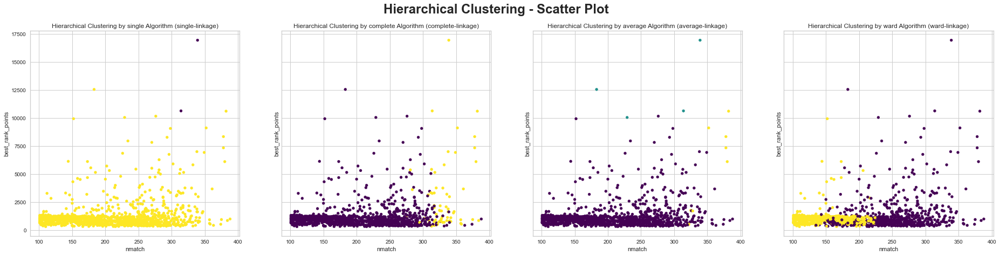

In [62]:
i = 0
f, axs = plt.subplots(ncols=4, figsize=(32,7), sharey=True)
plt.suptitle('Hierarchical Clustering - Scatter Plot', fontsize=24, fontweight='bold')
for model in models.keys():
    axs[i].set_title('Hierarchical Clustering by ' + model + ' Algorithm (' + methods[i] + '-linkage)')
    axs[i].scatter(df_performances['nmatch'].values, df_performances['best_rank_points'].values, c=model_labels[model] , s=25, cmap='viridis')
    axs[i].set_xlabel('nmatch')
    axs[i].set_ylabel('best_rank_points')
    i+=1

Now let's test the behavior of agglomerative clustering iterating on the number of clusters to find the best value based on silhouette scores.

In [63]:
max_clusters = 20
silhouette_scores = {}
silhouette_scores.fromkeys(methods)
for method in methods:
    print('Testing method ' + method)
    n_clusters = 2
    method_silhouette_scores = {}
    best_score = {}
    max_score = 0
    while n_clusters <= max_clusters:
        cluster = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage=method)
        cluster.fit_predict(scaled_dataframe)
        labels = cluster.labels_
        silhouette = silhouette_score(scaled_dataframe, labels, metric='euclidean')
        if (max_score < silhouette) : 
            max_score = silhouette
            best_score[n_clusters]= silhouette
        method_silhouette_scores[n_clusters]=silhouette
        n_clusters+=1
    print('Best Score -> ' + str(best_score))
    silhouette_scores[method] = method_silhouette_scores

Testing method single
Best Score -> {2: 0.5518578481398884}
Testing method complete
Best Score -> {2: 0.3785299242813096}
Testing method average
Best Score -> {2: 0.45436714384094173}
Testing method ward
Best Score -> {2: 0.36447832569704375}


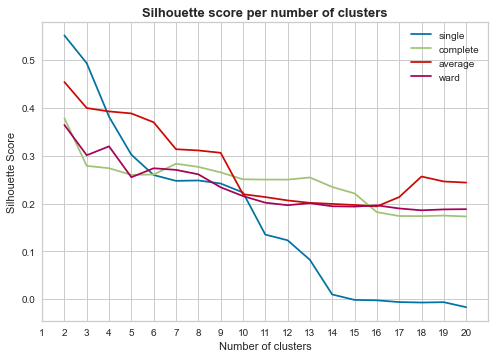

In [64]:
x_ticks = range(1,max_clusters + 1)
plt.title('Silhouette score per number of clusters', fontsize=13, fontweight='bold')
for method in silhouette_scores:
    keys = silhouette_scores[method].keys()
    values = silhouette_scores[method].values()
    plt.plot(keys, values)
    plt.xlabel('Number of clusters')
    plt.ylabel('Silhouette Score')
    plt.xticks(x_ticks)
    plt.xlim([1, max_clusters + 1])
    plt.legend(methods)
 

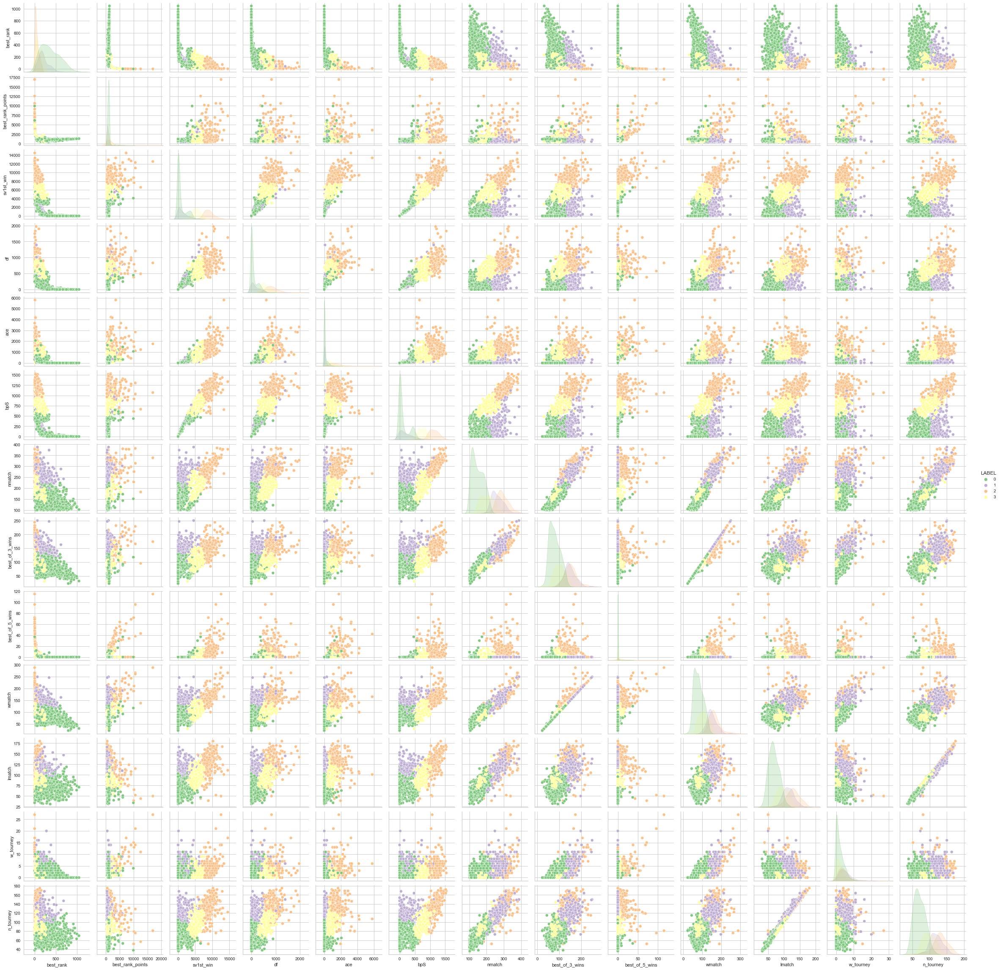

In [65]:
cluster = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')
cluster.fit_predict(scaled_dataframe)
# Extracting labels
cleaned_dataframe = df_performances.copy()
cleaned_dataframe["LABEL"] = cluster.labels_
# Pairplot
sns.pairplot(data = cleaned_dataframe, hue = "LABEL", palette = "Accent")


# X-MEANS

The X-means starts with only 1 cluster. We limit the number of clusters to 20 (that is the default value), so the X-means can stop before 20 but can't have more than 20 clusters. For the split os used the Bayesian Information Criterion that is also the default one.

In [66]:
amount_initial_centers = 1   #number of clusters at the start. xmeans starts with only one cluster
max_n_clusters = 20

initial_centers = kmeans_plusplus_initializer(df_performances, amount_initial_centers).initialize()
xmeans_instance = xmeans(df_performances, initial_centers, kmax=max_n_clusters)
xmeans_instance.process(); #split with bayesian Information Criterion

clusters = xmeans_instance.get_clusters();
centers = xmeans_instance.get_centers()

# Print total sum of metric errors
print("Total WCE:", xmeans_instance.get_total_wce())

print([len(c) for c in clusters])   

Total WCE: 653821662.8254131
[78, 61, 53, 63, 76, 146, 139, 188, 74, 34, 82, 57, 15, 22, 63, 27, 42, 19, 17, 9]


**partial plot**

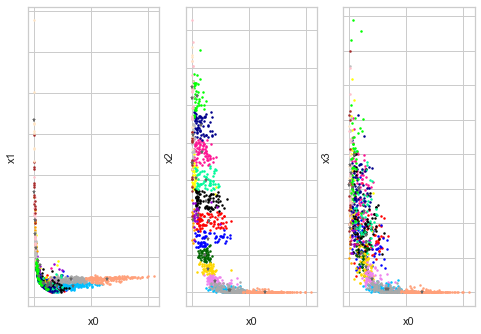

In [67]:
# display allocated clusters
visualizer = cluster_visualizer_multidim();
visualizer.append_clusters(clusters, df_performances.values.tolist())
visualizer.append_cluster(centers, None, marker = '*', markersize=5)
#visualizer.show()
visualizer.show(pair_filter=[[0, 1], [0, 2], [0, 3]])

**plot with sns library**

In [68]:
labels = np.zeros(df_performances.shape[0],  dtype=int) #num of rows
for i in range(len(clusters)):#number of cluster
    for j in clusters[i]: #index of row of dataset in cluster i
        labels[j] = int(i)

In [69]:
palette_n = sns.color_palette("hls", n_colors=len(clusters))
palette_n

[(0.86, 0.3712, 0.33999999999999997),
 (0.86, 0.5272, 0.33999999999999997),
 (0.86, 0.6832, 0.33999999999999997),
 (0.86, 0.8392000000000002, 0.33999999999999997),
 (0.7247999999999999, 0.86, 0.33999999999999997),
 (0.5688000000000001, 0.86, 0.33999999999999997),
 (0.41279999999999994, 0.86, 0.33999999999999997),
 (0.33999999999999997, 0.86, 0.42320000000000013),
 (0.33999999999999997, 0.86, 0.5792000000000002),
 (0.33999999999999997, 0.86, 0.7352000000000001),
 (0.33999999999999997, 0.8287999999999999, 0.86),
 (0.33999999999999997, 0.6727999999999997, 0.86),
 (0.33999999999999997, 0.5167999999999995, 0.86),
 (0.33999999999999997, 0.36079999999999973, 0.86),
 (0.4752000000000003, 0.33999999999999997, 0.86),
 (0.6311999999999998, 0.33999999999999997, 0.86),
 (0.7871999999999999, 0.33999999999999997, 0.86),
 (0.86, 0.33999999999999997, 0.7767999999999993),
 (0.86, 0.33999999999999997, 0.6207999999999999),
 (0.86, 0.33999999999999997, 0.46479999999999977)]

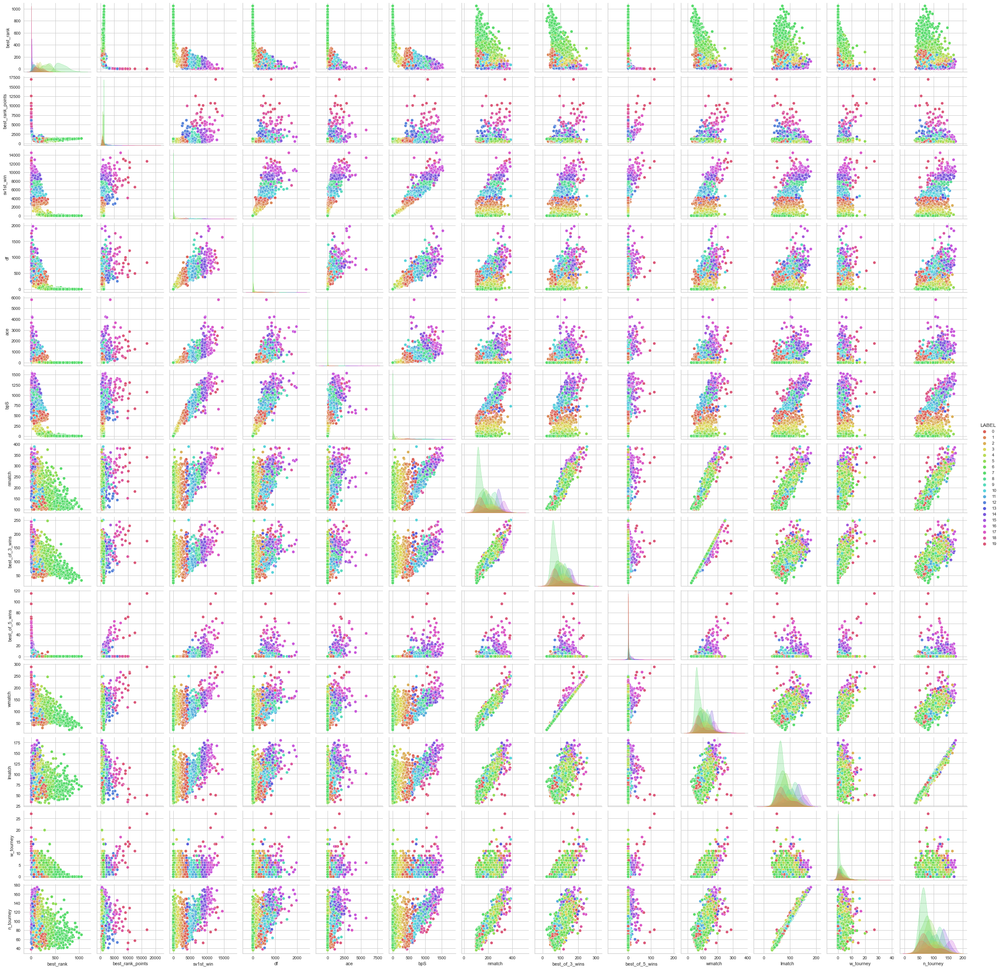

In [70]:
# Extracting labels
cleaned_dataframe = df_performances.copy()
cleaned_dataframe["LABEL"] = labels
# Pairplot
sns.pairplot(data = cleaned_dataframe, hue = "LABEL", palette = palette_n)

# G-Means clustering algorithm

<a href="https://pyclustering.github.io/docs/0.10.1/html/dc/d86/namespacepyclustering_1_1cluster_1_1gmeans.html">G-MEANS by PYCLUSTERING</a>
<br />
<i>Greg Hamerly and Charles Elkan. Learning the k in k-means. In Proceedings of the 16th International Conference on Neural Information Processing Systems, NIPS'03, pages 281–288, Cambridge, MA, USA, 2003. MIT Press.</i>
<br /><br />
The G-means algorithm starts with a small number of centers, and grows the number of centers. Each iteration of the G-Means algorithm splits into two those centers whose data appear not to come from a Gaussian distribution. G means repeatedly makes decisions based on a statistical test for the data assigned to each center.


In [71]:
data = df_performances.values.tolist()

 # Create instance of G-Means algorithm. By default the algorithm starts search from a single cluster.
max_n_clusters = 20
gmeans_instance = gmeans(data, k_max=max_n_clusters).process()
 
# Extract clustering results: clusters and their centers
clusters = gmeans_instance.get_clusters()
centers = gmeans_instance.get_centers()
 
# Returns sum of Euclidean Squared metric errors (SSE - Sum of Squared Errors)
print("Total WCE:", gmeans_instance.get_total_wce())

print([len(c) for c in clusters]) 

Total WCE: 635379529.2405875
[138, 188, 76, 146, 63, 53, 61, 19, 33, 58, 85, 88, 20, 16, 7, 1, 21, 37, 81, 74]


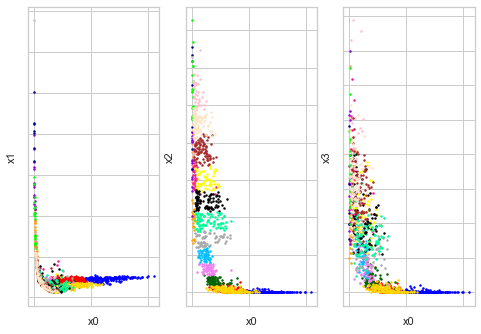

In [72]:
# visualize a sample of obtained clusters
visualizer = cluster_visualizer_multidim()
visualizer.append_clusters(clusters, data = df_performances.values.tolist())
visualizer.show(pair_filter=[[0, 1], [0, 2], [0, 3]])

In [73]:
# Print palette colors for clusters
palette_n = sns.color_palette("hls", n_colors=len(clusters))
palette_n

[(0.86, 0.3712, 0.33999999999999997),
 (0.86, 0.5272, 0.33999999999999997),
 (0.86, 0.6832, 0.33999999999999997),
 (0.86, 0.8392000000000002, 0.33999999999999997),
 (0.7247999999999999, 0.86, 0.33999999999999997),
 (0.5688000000000001, 0.86, 0.33999999999999997),
 (0.41279999999999994, 0.86, 0.33999999999999997),
 (0.33999999999999997, 0.86, 0.42320000000000013),
 (0.33999999999999997, 0.86, 0.5792000000000002),
 (0.33999999999999997, 0.86, 0.7352000000000001),
 (0.33999999999999997, 0.8287999999999999, 0.86),
 (0.33999999999999997, 0.6727999999999997, 0.86),
 (0.33999999999999997, 0.5167999999999995, 0.86),
 (0.33999999999999997, 0.36079999999999973, 0.86),
 (0.4752000000000003, 0.33999999999999997, 0.86),
 (0.6311999999999998, 0.33999999999999997, 0.86),
 (0.7871999999999999, 0.33999999999999997, 0.86),
 (0.86, 0.33999999999999997, 0.7767999999999993),
 (0.86, 0.33999999999999997, 0.6207999999999999),
 (0.86, 0.33999999999999997, 0.46479999999999977)]

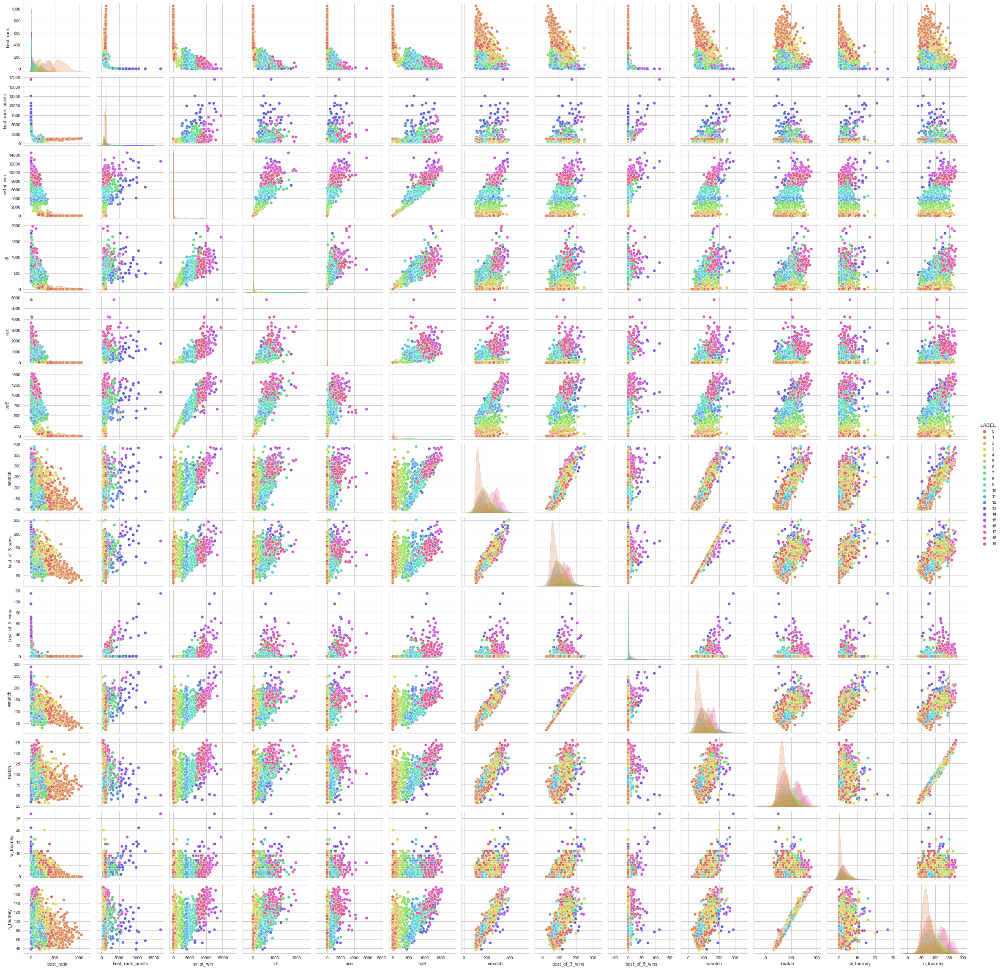

In [74]:
# Prepare labels
labels = np.zeros(df_performances.shape[0],  dtype=int) #num of rows
for i in range(len(clusters)):#number of cluster
    for j in clusters[i]: #index of row of dataset in cluster i
        labels[j] = int(i)

# Print 
cleaned_dataframe = df_performances.copy()
cleaned_dataframe["LABEL"] = labels
# Pairplot
sns.pairplot(data = cleaned_dataframe, hue = "LABEL", palette = palette_n)